# Gab2Vec

In [2]:
# IMPORTS
import re
import numpy as np
import pandas as pd
from nltk.tokenize import sent_tokenize, word_tokenize
from gensim.models import Word2Vec
from sklearn.decomposition import PCA
from matplotlib import pyplot as plt

# My usual preferences
plt.rcParams['figure.dpi'] = 300
plt.rcParams["figure.figsize"] = (10,5)

# Gives us some interactive options
import plotly.graph_objects as go

## Data

In [2]:
# DATA
with open("../queue/gabs.txt", "r") as f:
    gabs = f.readlines()

# Make one big string
# Note the added period: not all gabs have punctuation,
# so we are forcing a sentence at least at the end of each gab.
gab_text = ". ".join(gabs)

# An empty list which we will fill with sentences to feed w2v
# Each sentence will itself be a list of tokens (words)
data = []

# Iterate through each sentence in the big string
for sentence in sent_tokenize(gab_text):
    # A list to hold our words
    temp = []
    # tokenize the sentence into words
    for word in word_tokenize(sentence):
        temp.append(word.lower())
    # Now we add the list of words to the list of sentences
    data.append(temp)

# How many "sentences" do we have?
print(len(data))

148447


## Creating & Exploring the Model

In [3]:
# Create our word embedding model
model = Word2Vec(sentences=data, 
                 window = 3, 
                 min_count=1, 
                 vector_size = 10)

**Words tried**: good, bad, dirty, clean, positive, negative, democrat, republican, left, ugly, beauty / beautiful.

**Note**: `topn` is optional here. Without it, you'll get a longer list.

`w1` can also be a list.

In [12]:
# Similarity
w1 = ["chicom"]
model.wv.most_similar (positive=w1, topn=5)

[('sea', 0.991249680519104),
 ('expert', 0.9911260604858398),
 ('planet', 0.9885665774345398),
 ('indian', 0.98797208070755),
 ('agent', 0.9874516129493713)]

In [5]:
# similarity between two different words
model.wv.similarity(w1="dirty", w2="smelly")

0.53169984

In [6]:
# similarity between two different words
model.wv.similarity(w1="dirty", w2="lib")

0.6277985

In [7]:
# Which one is the odd one out in this list?
model.wv.doesnt_match(["conservative","activist","fighter"])

'conservative'

In [8]:
# Exclude options
w1 = ["activist"]
w2 = ["good"]
model.wv.most_similar(positive = w1, negative = w2, topn = 5)

[('moreno', 0.9636865258216858),
 ('de', 0.951269268989563),
 ('en', 0.9498857855796814),
 ('🇺🇸trump', 0.94498610496521),
 ('ببخش', 0.9403583407402039)]

In [9]:
# list the vocabulary words
words = list(model.wv.index_to_key)
print(words[100:110])

['an', 'thank', 's', 'ellipsis', '``', 'has', '-', 'going', 'back', 'new']


In [15]:
# Save all this

# Old way
filename = "gab2vec.txt"
model.wv.save_word2vec_format(filename, binary = False)

# New way
model.save("gab2vec.model")

In [5]:
# Bring it back
model = Word2Vec.load("../queue/gab2vec.model")
words = list(model.wv.index_to_key)

## Interactive Visualization

In [6]:
#pass the embeddings to PCA
X = model.wv.get_normed_vectors()
pca = PCA(n_components=2)
result = pca.fit_transform(X)

#create df from the pca results
pca_df = pd.DataFrame(result, columns = ['x','y'])

#add the words for the hover effect
pca_df['word'] = words
pca_df.head()

,x,y,word
0,-0.010525,0.534663,.
1,0.228947,-0.365429,''
2,0.031318,0.787196,i
3,0.218515,-0.356104,<
4,0.172501,-0.449868,>


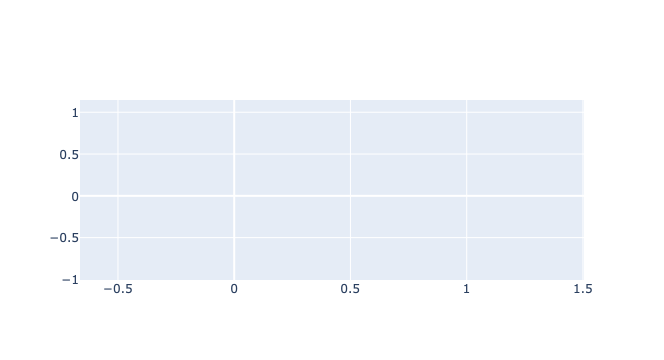

In [7]:
# This is just for color
N = 1000000

# Get the words for labels
words = list(model.wv.index_to_key)

# Instantiate the figure
fig = go.Figure(data=go.Scattergl(
    # Assign the values to x and y
    x = pca_df['x'],
    y = pca_df['y'],
    mode='markers',
    marker=dict(
        color=np.random.randn(N),
        colorscale='Viridis',
        line_width=1
    ),
    # Label the dots with the words
    text=pca_df['word'],
    textposition="bottom center"
))

fig.show()